## Project Overview

This project leverages various advanced techniques for loan risk prediction, focusing on data quality, causality, and explainability. Using ydata-profiling, comprehensive reports were generated to assess data quality and facilitate exploratory data analysis (EDA). Granger causality analysis identified significant predictors of loan status, informing feature selection. The DoWhy library was used to build causal models, distinguishing true causative effects from correlations and providing valuable insights for loan risk management. Explainable AI was integrated with a Decision Tree classifier to enhance transparency and trustworthiness in model decisions.

Project Content
1. Import Necessary Libraries
2. Data Preparation and Exploration
    2.1 Identifying Null Values,
    2.2 Handle Null values,
    2.3 Handle Date Columns,
    2.4 Handle Boolean Features,
    2.5 Target Variable Defining,
    2.6 Handling Rest of the Missing Values Before Encoding,
    2.7 Feature Importance,
    2.8 Feature Selection
3. Data Visualization
4. Granger Causality Matrix
    4.1 Matrix,
    4.2 Matrix Visualization,
    4.3 Feature Significance from Granger Causality
5. Causal AI Analysis with DoWhy Library
    5.1 Positive Causal Effect,
    5.2 Negative Causal Effect
6. Data Splitting
7. Sensible Model Training
8. Model Visualization and Evidence
9. Predicted Loan Risk on an Applicant
10. Explanable AI
    10.1 Classification Report,
    10.2 Tree Diagram
11. Model Validation

#### 1. Import Necessary Libraries

In [46]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from scipy.sparse import save_npz, csr_matrix
from scipy import stats
from ydata_profiling import ProfileReport
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier, plot_tree
from causallearn.search.ConstraintBased.PC import pc
from causallearn.utils.GraphUtils import GraphUtils
from dowhy import CausalModel
import networkx as nx
import statsmodels.api as sm
from statsmodels.tsa.stattools import grangercausalitytests
from concurrent.futures import ThreadPoolExecutor, TimeoutError
from sklearn.model_selection import cross_val_score


#### 2. Data Preparation and Exploration

In [47]:
# Load the data
loan_df = pd.read_csv('loan.csv')
payment_df = pd.read_csv('payment.csv')
clarity_df = pd.read_csv('clarity_underwriting_variables.csv')

In [48]:
# Merging data on loanId
data = loan_df.merge(payment_df, on='loanId', how='left').merge(clarity_df, left_on='clarityFraudId', right_on='underwritingid', how='left')

#View Merged data shape (Row, Column)
data.shape

#View Merged data head (10)
data.head()

#View Merged data info
data.info()

#View Merged data statistics
data.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1227094 entries, 0 to 1227093
Data columns (total 81 columns):
 #   Column                                                                                               Non-Null Count    Dtype  
---  ------                                                                                               --------------    -----  
 0   loanId                                                                                               1226838 non-null  object 
 1   anon_ssn                                                                                             1227094 non-null  object 
 2   payFrequency                                                                                         1225821 non-null  object 
 3   apr                                                                                                  1223172 non-null  float64
 4   applicationDate                                                                           

,apr,nPaidOff,isFunded,loanAmount,originallyScheduledPaymentAmount,leadCost,hasCF,installmentIndex,principal,fees,paymentAmount,.underwritingdataclarity.clearfraud.clearfraudinquiry.thirtydaysago,.underwritingdataclarity.clearfraud.clearfraudinquiry.twentyfourhoursago,.underwritingdataclarity.clearfraud.clearfraudinquiry.oneminuteago,.underwritingdataclarity.clearfraud.clearfraudinquiry.onehourago,.underwritingdataclarity.clearfraud.clearfraudinquiry.ninetydaysago,.underwritingdataclarity.clearfraud.clearfraudinquiry.sevendaysago,.underwritingdataclarity.clearfraud.clearfraudinquiry.tenminutesago,.underwritingdataclarity.clearfraud.clearfraudinquiry.fifteendaysago,.underwritingdataclarity.clearfraud.clearfraudinquiry.threesixtyfivedaysago,.underwritingdataclarity.clearfraud.clearfraudindicator.totalnumberoffraudindicators,.underwritingdataclarity.clearfraud.clearfraudindicator.maxnumberofssnswithanybankaccount,.underwritingdataclarity.clearfraud.clearfraudidentityverification.overallmatchreasoncode,clearfraudscore
count,1.223172e+06,1.226708e+06,1.227094e+06,1.224844e+06,1.227094e+06,1.227094e+06,1.227094e+06,689364.000000,689364.000000,689364.000000,689364.000000,562324.000000,562324.000000,562324.000000,562324.000000,562324.000000,562324.000000,562324.000000,562324.000000,562324.000000,562100.000000,562100.000000,561902.000000,560733.000000
mean,5.364715e+02,1.967779e-01,5.475391e-01,6.040175e+02,1.671015e+03,9.947027e+00,7.320148e-01,10.553222,45.557543,67.003994,112.680232,7.269395,4.578794,2.286122,3.962835,10.375428,5.408524,3.244000,6.147303,19.683689,2.114083,7.016122,11.670409,686.009966
std,1.222177e+02,7.411603e-01,4.977351e-01,4.836215e+02,1.326923e+03,1.766128e+01,4.429100e-01,8.049530,81.724683,59.789510,105.783710,6.374130,3.310076,1.415536,2.679312,10.390031,4.139469,2.087171,5.019731,23.551910,1.254057,78.833252,13.951530,127.487377
min,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,-8.167100e+02,0.000000e+00,0.000000e+00,1.000000,-303.370000,-42.560000,-337.700000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,122.000000
25%,4.499900e+02,0.000000e+00,0.000000e+00,3.500000e+02,1.034750e+03,3.000000e+00,0.000000e+00,5.000000,13.180000,28.820000,56.810000,3.000000,3.000000,1.000000,3.000000,4.000000,3.000000,2.000000,3.000000,6.000000,1.000000,1.000000,1.000000,594.000000
50%,5.900000e+02,0.000000e+00,1.000000e+00,5.000000e+02,1.291090e+03,3.000000e+00,1.000000e+00,9.000000,27.610000,51.300000,86.340000,5.000000,3.000000,2.000000,3.000000,7.000000,4.000000,3.000000,5.000000,12.000000,2.000000,1.000000,11.000000,694.000000
75%,6.010000e+02,0.000000e+00,1.000000e+00,6.000000e+02,1.809097e+03,1.000000e+01,1.000000e+00,14.000000,53.380000,86.440000,135.090000,9.000000,5.000000,3.000000,5.000000,13.000000,6.000000,4.000000,7.000000,24.000000,3.000000,2.000000,15.000000,785.000000
max,7.055900e+02,2.100000e+01,1.000000e+00,5.000000e+03,1.996363e+04,2.000000e+02,1.000000e+00,105.000000,4000.000000,1257.710000,4063.600000,89.000000,60.000000,14.000000,35.000000,143.000000,64.000000,35.000000,76.000000,438.000000,8.000000,4056.000000,125.000000,965.000000


2.1 Identifying null values: 

preventing truncation of displayed data with pandas display setting.

In [49]:
# Adjust pandas display settings to show all rows and columns
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

null_values = data.isnull().sum()
print(null_values)


loanId                                                                                                     256
anon_ssn                                                                                                     0
payFrequency                                                                                              1273
apr                                                                                                       3922
applicationDate                                                                                              0
originated                                                                                                   0
originatedDate                                                                                          531885
nPaidOff                                                                                                   386
approved                                                                                                     0
i

2.2 Handle Null Values: 

Dropping columns with excessive missing values prevents the model from being trained on incomplete or unreliable data, thus improving its robustness and accuracy. However, this dataset has excessive missing values and removing them can remove important features or can turn the dataset row numbers to zero. which is why i am using this method of removing feaatures that have a percentage of null values more than the set threshold. this way, unwanted unimportant features can be reduced and the data size will not drop to zero.

In [51]:
# Calculate the percentage of missing values for each column
missing_percentage = data.isnull().mean() * 100
missing_percentage = missing_percentage.sort_values(ascending=False)

# Display columns with more than 55% missing values
high_missing_cols = missing_percentage[missing_percentage > 55]
print(high_missing_cols)

# Count the number of columns that will be dropped
num_columns_dropped = len(high_missing_cols)

# Display the column names and the count 
print(f"\n\nNumber of columns to be dropped: {num_columns_dropped}")

.underwritingdataclarity.clearfraud.clearfraudidentityverification.phonetype                           98.611924
.underwritingdataclarity.clearfraud.clearfraudidentityverification.ssnnamereasoncodedescription        97.607029
.underwritingdataclarity.clearfraud.clearfraudidentityverification.ssnnamereasoncode                   97.607029
paymentReturnCode                                                                                      97.430270
.underwritingdataclarity.clearfraud.clearfraudidentityverification.nameaddressreasoncodedescription    94.820527
.underwritingdataclarity.clearfraud.clearfraudidentityverification.nameaddressreasoncode               94.820527
.underwritingdataclarity.clearfraud.clearfraudidentityverification.ssndobreasoncode                    91.428448
.underwritingdataclarity.clearfraud.clearfraudindicator.driverlicenseinconsistentwithonfile            91.001667
.underwritingdataclarity.clearfraud.clearfraudindicator.workphonepreviouslylistedascellphone    

In [52]:
# Drop columns with more than 55% missing values
data = data.drop(columns=high_missing_cols.index)


2.3 Handliing Date Columns:

Identifying date columns for consistent handling and preventing any date information from being overlooked. Converts these columns to datetime objects, standardizing dates for accurate temporal analysis. After conversion, the code checks for NaT values to prevent issues that may can appear in further analysis. Missing dates are handled by filling them with a consistent, non-null placeholder to avoid errors during model training and analysis. The datetime columns are then transformed into numerical timestamps, making them suitable for machine learning algorithms and analysis to avoid errors. Finally, verifying data types ensures data integrity and readiness for the next steps in modeling.

In [53]:
# Identify date columns
date_columns = [col for col in data.columns if 'date' in col.lower() or 'time' in col.lower()]

# Print identified date columns
print(f"Identified Date Columns: {date_columns}")

# Print identified date column count
print(f"\n\nTotal Date Columns: {len(date_columns)}")

# Convert date columns to datetime objects
if 'applicationDate' in data.columns:
    data['applicationDate'] = pd.to_datetime(data['applicationDate'], errors='coerce')
if 'originatedDate' in data.columns:
    data['originatedDate'] = pd.to_datetime(data['originatedDate'], errors='coerce')
if 'paymentDate' in data.columns:
    data['paymentDate'] = pd.to_datetime(data['paymentDate'], errors='coerce')
if '.underwritingdataclarity.clearfraud.clearfraudindicator.inquiryageyoungerthanssnissuedate' in data.columns:
    data['.underwritingdataclarity.clearfraud.clearfraudindicator.inquiryageyoungerthanssnissuedate'] = pd.to_datetime(data['.underwritingdataclarity.clearfraud.clearfraudindicator.inquiryageyoungerthanssnissuedate'], errors='coerce')
if '.underwritingdataclarity.clearfraud.clearfraudindicator.inputssnissuedatecannotbeverified' in data.columns:
    data['.underwritingdataclarity.clearfraud.clearfraudindicator.inputssnissuedatecannotbeverified'] = pd.to_datetime(data['.underwritingdataclarity.clearfraud.clearfraudindicator.inputssnissuedatecannotbeverified'], errors='coerce')
if '.underwritingdataclarity.clearfraud.clearfraudindicator.creditestablishedpriortossnissuedate' in data.columns:
    data['.underwritingdataclarity.clearfraud.clearfraudindicator.creditestablishedpriortossnissuedate'] = pd.to_datetime(data['.underwritingdataclarity.clearfraud.clearfraudindicator.creditestablishedpriortossnissuedate'], errors='coerce')
if '.underwritingdataclarity.clearfraud.clearfraudindicator.bestonfilessnissuedatecannotbeverified' in data.columns:
    data['.underwritingdataclarity.clearfraud.clearfraudindicator.bestonfilessnissuedatecannotbeverified'] = pd.to_datetime(data['.underwritingdataclarity.clearfraud.clearfraudindicator.bestonfilessnissuedatecannotbeverified'], errors='coerce')
    
# Check for any NaT values after conversion
print("\n\nChecking for NaT Values After Conversion: ")
print(data[['applicationDate', 'originatedDate', 'paymentDate', '.underwritingdataclarity.clearfraud.clearfraudindicator.inquiryageyoungerthanssnissuedate', '.underwritingdataclarity.clearfraud.clearfraudindicator.inputssnissuedatecannotbeverified', '.underwritingdataclarity.clearfraud.clearfraudindicator.creditestablishedpriortossnissuedate', '.underwritingdataclarity.clearfraud.clearfraudindicator.bestonfilessnissuedatecannotbeverified']].isna().sum())

# Handling NaT values by filling with a placeholder
data['applicationDate'].fillna(pd.Timestamp('1900-01-01'), inplace=True)
data['originatedDate'].fillna(pd.Timestamp('1900-01-01'), inplace=True)
data['paymentDate'].fillna(pd.Timestamp('1900-01-01'), inplace=True)
data['.underwritingdataclarity.clearfraud.clearfraudindicator.inquiryageyoungerthanssnissuedate'].fillna(pd.Timestamp('1900-01-01'), inplace=True)
data['.underwritingdataclarity.clearfraud.clearfraudindicator.inputssnissuedatecannotbeverified'].fillna(pd.Timestamp('1900-01-01'), inplace=True)
data['.underwritingdataclarity.clearfraud.clearfraudindicator.creditestablishedpriortossnissuedate'].fillna(pd.Timestamp('1900-01-01'), inplace=True)
data['.underwritingdataclarity.clearfraud.clearfraudindicator.bestonfilessnissuedatecannotbeverified'].fillna(pd.Timestamp('1900-01-01'), inplace=True)

print("\n\nNaT Value Handliing is Done!!!")

Identified Date Columns: ['applicationDate', 'originatedDate', 'paymentDate', '.underwritingdataclarity.clearfraud.clearfraudindicator.inquiryageyoungerthanssnissuedate', '.underwritingdataclarity.clearfraud.clearfraudindicator.inputssnissuedatecannotbeverified', '.underwritingdataclarity.clearfraud.clearfraudindicator.creditestablishedpriortossnissuedate', '.underwritingdataclarity.clearfraud.clearfraudindicator.bestonfilessnissuedatecannotbeverified']


Total Date Columns: 7


Checking for NaT Values After Conversion: 
applicationDate                                                                                      1130
originatedDate                                                                                     532639
paymentDate                                                                                        554976
.underwritingdataclarity.clearfraud.clearfraudindicator.inquiryageyoungerthanssnissuedate         1227094
.underwritingdataclarity.clearfraud.clearfraudind

In [54]:
# Check for any NaT values after NaT Value Handling
print("Checking for NaT Values After NaT Value Handling: ")
print(data[['applicationDate', 'originatedDate', 'paymentDate', '.underwritingdataclarity.clearfraud.clearfraudindicator.inquiryageyoungerthanssnissuedate', '.underwritingdataclarity.clearfraud.clearfraudindicator.inputssnissuedatecannotbeverified', '.underwritingdataclarity.clearfraud.clearfraudindicator.creditestablishedpriortossnissuedate', '.underwritingdataclarity.clearfraud.clearfraudindicator.bestonfilessnissuedatecannotbeverified']].isna().sum())

# Convert datetime columns to numeric timestamps
for col in date_columns:
    data[col] = data[col].astype('int64') / 10**9  # Convert to seconds since epoch

# Verify all columns are numeric
print("Data types after preprocessing:\n", data.dtypes)

#Check data info to confirm datetime object was created
data.info()

Checking for NaT Values After NaT Value Handling: 
applicationDate                                                                                   0
originatedDate                                                                                    0
paymentDate                                                                                       0
.underwritingdataclarity.clearfraud.clearfraudindicator.inquiryageyoungerthanssnissuedate         0
.underwritingdataclarity.clearfraud.clearfraudindicator.inputssnissuedatecannotbeverified         0
.underwritingdataclarity.clearfraud.clearfraudindicator.creditestablishedpriortossnissuedate      0
.underwritingdataclarity.clearfraud.clearfraudindicator.bestonfilessnissuedatecannotbeverified    0
dtype: int64
Data types after preprocessing:
 loanId                                                                                                object
anon_ssn                                                                                      

2.4 Handling Boolean Features:
    
Converts boolean columns in the dataset to integer values. Booleans are converted to integers (True becomes 1, and False becomes 0) to ensure compatibility with machine learning algorithms that require numerical input. This transformation standardizes the data types. Another important step for data integrity and effective use of the entire dataset in predictive modeling.

In [55]:
# Convert boolean columns to integers
bool_columns = data.select_dtypes(include=['bool']).columns
for col in bool_columns:
    data[col] = data[col].astype(int)

2.5 Target Variable Defining:

Target variable loanStatus for binary classification. Encodes loanStatus into "safe" loans (paid off) and "risky" loans (not paid off). The positive status is specified as "Paid Off Loan," and the target variable is converted to binary, with 1 indicating a safe loan and 0 indicating a risky loan. This transformation is crucial for the classification model to correctly learn and predict loan risk. The distribution of the target variable is checked before splitting the data to ensure a balanced representation of classes. Finally, the features (X) and target variable (y) are separated for further modeling. This step sets the foundation for training a machine learning model on a well prepared dataset.

In [56]:
# Define target variable
target_variable = 'loanStatus'

# Encoding the loanStatus for binary classification (1 for safe, 0 for risky)
# Define positive status
positive_statuses = ["Paid Off Loan"]
# Convert to binary target variable
data[target_variable] = data[target_variable].apply(lambda x: 1 if x in positive_statuses else 0)

# Check the distribution of the target variable before split
print("\nTarget variable distribution before split:")
print(data[target_variable].value_counts())

# Separate features and target variable
X = data.drop(target_variable, axis=1)
y = data[target_variable]


Target variable distribution before split:
loanStatus
0    1038254
1     188840
Name: count, dtype: int64


In [57]:
# Check unique values in loanStatus
print("Unique values in loanStatus before encoding:")
print(data[target_variable].unique())


Unique values in loanStatus before encoding:
[0 1]


2.6 Handling Rest of the Missing Values Before Encoding:

Using a 'missing' placeholder for categorical columns ensures that all data remains complete and avoids NaN values during encoding. Allows the LabelEncoder to include and transform missing values smoothly. After encoding, rows with the 'missing' label are filtered out, maintaining data integrity and ensuring effective model training.

In [58]:
# Handle missing values in numerical columns
numerical_cols = X.select_dtypes(include=['float64', 'int64']).columns
numerical_imputer = SimpleImputer(strategy='mean')
X[numerical_cols] = numerical_imputer.fit_transform(X[numerical_cols])

# Handle categorical columns
categorical_columns = X.select_dtypes(include=['object']).columns

# Handle missing values in categorical columns before encoding by assigning 'missing' placeholder
X[categorical_columns] = X[categorical_columns].fillna('missing')


In [59]:
# Initialize the LabelEncoder
label_encoder = LabelEncoder()

# Fit the LabelEncoder on the modified categorical columns to include the 'missing' label
for col in categorical_columns:
    label_encoder.fit(X[col].unique().tolist() + ['missing'])
    X[col] = label_encoder.transform(X[col])
    

In [60]:
# Check for null values after encoding
null_values_after_encoding = X.isnull().sum()
print("Null values after encoding:\n", null_values_after_encoding)

# Remove rows where any column has the label for 'missing'
missing_label = label_encoder.transform(['missing'])[0]

# Filter out rows with the 'missing' label
mask = np.all(X != missing_label, axis=1)
X = X[mask]
y = y[mask]

# Check for null values after removing 'missing' labeled rows
null_values_after_removal = X.isnull().sum()
print("Null values after removing 'missing' labeled rows:\n", null_values_after_removal)



Null values after encoding:
 loanId                                                                                               0
anon_ssn                                                                                             0
payFrequency                                                                                         0
apr                                                                                                  0
applicationDate                                                                                      0
originated                                                                                           0
originatedDate                                                                                       0
nPaidOff                                                                                             0
approved                                                                                             0
isFunded                                    

In [61]:
print(X.shape)

# Ensure all data in X is numeric
X = X.apply(pd.to_numeric, errors='coerce')

# Verify all columns are numeric
print("\nData types after preprocessing:\n", X.dtypes)

X.isnull().sum()

X.info()

(562348, 66)

Data types after preprocessing:
 loanId                                                                                                 int32
anon_ssn                                                                                               int32
payFrequency                                                                                           int32
apr                                                                                                  float64
applicationDate                                                                                      float64
originated                                                                                             int32
originatedDate                                                                                       float64
nPaidOff                                                                                             float64
approved                                                                         

2.7 Feature Importance:

RandomForestClassifier to identify importance of each feature in predicting the target variable. The model is initialized with 100 estimators for robust results, fitted to the data, and faster run-time. Feature importances are extracted and stored in a DataFrame, which is then indexed and sorted for better visualization. The sorted DataFrame is plotted as a bar chart to visually display the importance of each feature. This helps in understanding which features contribute the most to the model's predictions, enabling more informed decisions for feature selection and model refinement.

<Figure size 2000x1500 with 0 Axes>

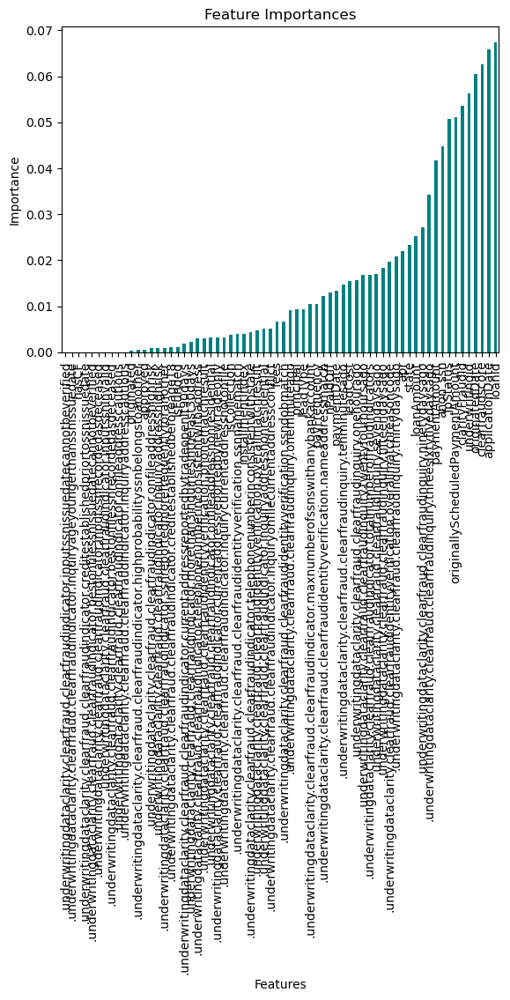

In [62]:
# Initialize RandomForestClassifier with n_estimators as 100
model = RandomForestClassifier(n_estimators=100, random_state=42)

# Fit the model
model.fit(X, y)

# Get the importance of the resulting features
importances = model.feature_importances_

# Create a DataFrame for visualization
final_df = pd.DataFrame({"Features": X.columns, "Importance": importances})

# Set the index for better visualization
final_df.set_index('Features', inplace=True)

# Sort in ascending order for better visualization
final_df = final_df.sort_values('Importance')

# Plot the feature importances in bars
plt.figure(figsize=(20, 15))
final_df.plot(kind='bar', color='teal', legend=False)
plt.title('Feature Importances')
plt.ylabel('Importance')
plt.xlabel('Features')
plt.show()


2.8 Feature Selection:

Selects the top 20 most important features identified by the RandomForestClassifier. By focusing on the top features, it reduces the dimensionality of the dataset, which can lead to more efficient and potentially more accurate modeling. The reduced feature set is combined with the target variable to form a new dataset, which is then saved to a CSV file for further use. This approach simplifies the data, making it easier to manage and analyze, while retaining the most critical information for predicting loan risk. The final shape of the DataFrame is displayed to confirm the reduction in features.

In [63]:
# Select top 20 features
top_features = final_df.tail(20).index.tolist()

# Reduce the data to top 20 features
X_reduced = X[top_features]

# Add the target variable back to the reduced data
data_reduced = pd.concat([X_reduced, y], axis=1)

# Save the reduced dataset to a new CSV file
data_reduced.to_csv('reduced_data.csv', index=False)

# Display the final DataFrame shape
print("Final DataFrame shape after feature selection:", data_reduced.shape)

Final DataFrame shape after feature selection: (562348, 21)


In [64]:
clean_data = pd.read_csv('reduced_data.csv')
clean_data.shape

#### 3. Data Visualization

ydata_profiling report (Extensive EDA):

Data quality profiling and exploratory data analysis (EDA) are crucial steps in the data science and machine learning development process. ydata-profiling, a leading Python package, significantly enhances these steps by automating and standardizing the generation of detailed reports. This package creates comprehensive profiling reports that include statistics, distributions, and correlations for all features, providing a detailed overview of the data. These reports help identify potential issues, insights, and patterns, facilitating better data preparation and informed decision-making for further analysis or modeling. The ability to quickly generate such reports in a single line of code streamlines the data understanding phase and allows for interactive exploration of the dataset's characteristics.

In [65]:
profile = ProfileReport(clean_data, title="Profiling Report")
profile


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### 4. Granger Causality Matrix

Granger Causality is an econometric test used to verify the usefulness or affect of one variable to forecast another.

In [66]:
# Function for Granger Causality matrix with a timeout
def granger_causality_matrix(data, max_lag=3, timeout=10):
    variables = data.columns
    df_matrix = pd.DataFrame(np.zeros((len(variables), len(variables))), columns=variables, index=variables)

    def perform_granger_test(row, col):
        try:
            test_result = grangercausalitytests(data[[row, col]], max_lag, verbose=False)
            p_values = [round(test_result[i + 1][0]['ssr_ftest'][1], 4) for i in range(max_lag)]
            return np.min(p_values)
        except Exception as e:
            print(f"Error processing {row} -> {col}: {e}")
            return np.nan

    with ThreadPoolExecutor() as executor:
        futures = {}
        for col in df_matrix.columns:
            for row in df_matrix.index:
                if col != row:
                    futures[(row, col)] = executor.submit(perform_granger_test, row, col)

        for (row, col), future in futures.items():
            try:
                df_matrix.loc[row, col] = future.result(timeout=timeout)
            except TimeoutError:
                df_matrix.loc[row, col] = np.nan

    df_matrix.columns = [var + '_x' for var in variables]
    df_matrix.index = [var + '_y' for var in variables]
    return df_matrix



4.1 Matrix:

In a Granger causality matrix, p-values indicate whether one time series can predict another. The null hypothesis states that one variable does not Granger-cause the other. A p-value below 0.05 means we reject this null hypothesis, suggesting a significant causal relationship. Conversely, a p-value of 0.05 or higher indicates no significant causality. This threshold helps identify predictive relationships within the data from this matrix, with lower p-values showing stronger evidence of one variable's ability to forecast another.

In [67]:
# Compute Granger causality matrix for the clean dataset
granger_matrix = granger_causality_matrix(clean_data, max_lag=3, timeout=10)

# Display the Granger causality matrix
print("\nGranger Causality Matrix:\n")
granger_matrix



Granger Causality Matrix:



,.underwritingdataclarity.clearfraud.clearfraudindicator.totalnumberoffraudindicators_x,.underwritingdataclarity.clearfraud.clearfraudinquiry.sevendaysago_x,.underwritingdataclarity.clearfraud.clearfraudinquiry.fifteendaysago_x,.underwritingdataclarity.clearfraud.clearfraudidentityverification.overallmatchreasoncode_x,.underwritingdataclarity.clearfraud.clearfraudinquiry.thirtydaysago_x,apr_x,state_x,loanAmount_x,.underwritingdataclarity.clearfraud.clearfraudinquiry.ninetydaysago_x,.underwritingdataclarity.clearfraud.clearfraudinquiry.threesixtyfivedaysago_x,paymentAmount_x,anon_ssn_x,fpStatus_x,originallyScheduledPaymentAmount_x,clarityFraudId_x,underwritingid_x,originatedDate_x,clearfraudscore_x,applicationDate_x,loanId_x,loanStatus_x
.underwritingdataclarity.clearfraud.clearfraudindicator.totalnumberoffraudindicators_y,0.0000,0.6095,0.8296,0.1541,0.8068,0.0000,0.0124,0.0000,0.3332,0.0000,0.2773,0.5050,0.0000,0.0000,0.3051,0.3040,0.0000,0.0141,0.3304,0.4345,0.0463
.underwritingdataclarity.clearfraud.clearfraudinquiry.sevendaysago_y,NaN,0.0000,0.2281,0.0388,0.2698,0.0034,0.0815,0.0000,0.0080,0.0008,0.1569,0.0336,0.0000,0.0000,0.0737,0.0163,0.0000,0.4178,0.0222,0.0010,0.2715
.underwritingdataclarity.clearfraud.clearfraudinquiry.fifteendaysago_y,0.4904,0.0000,0.0000,0.0198,0.0023,0.0021,0.0321,0.0000,0.0000,0.0000,0.2176,0.1401,0.0000,0.0000,0.0094,0.0043,0.0000,0.4672,0.0664,0.0000,0.1219
.underwritingdataclarity.clearfraud.clearfraudidentityverification.overallmatchreasoncode_y,0.6797,0.5541,0.0591,0.0000,0.0203,0.0033,0.8342,0.3305,0.9074,0.5412,0.6988,0.0343,0.0000,0.3127,0.7652,0.7970,0.0000,0.1443,0.0027,0.6906,0.0028
.underwritingdataclarity.clearfraud.clearfraudinquiry.thirtydaysago_y,0.1685,0.0000,0.0000,0.1455,0.0000,0.0005,0.0021,0.0000,0.0000,0.0000,0.1341,0.3278,0.0007,0.0000,0.0003,0.0002,0.0031,0.0349,0.0322,0.0000,0.2132
apr_y,0.0000,0.0003,0.0000,0.1754,0.0000,0.0000,0.0000,0.0000,0.0005,0.0025,0.0000,0.0353,0.0000,0.0000,0.4661,0.4940,0.0000,0.0000,0.7214,0.6930,0.0000
state_y,0.0344,0.3852,0.0932,0.2162,0.1029,0.0000,0.0000,0.0000,0.0934,0.0457,0.0000,0.0323,0.4688,0.0000,0.0000,0.0000,0.9125,0.0000,0.1341,0.0002,0.2123
loanAmount_y,0.0007,0.0032,0.0000,0.0076,0.0000,0.0000,0.0000,0.0000,0.0001,0.0011,0.0000,0.0224,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.1481,0.0000,0.1890
.underwritingdataclarity.clearfraud.clearfraudinquiry.ninetydaysago_y,0.2505,0.0000,0.0000,0.3133,0.0001,0.0009,0.0010,0.0000,0.0000,0.0000,0.3949,0.0756,0.2776,0.0000,0.0085,0.0159,0.0000,0.0000,0.4597,0.0000,0.1686
.underwritingdataclarity.clearfraud.clearfraudinquiry.threesixtyfivedaysago_y,0.0035,0.0000,0.0222,0.8862,0.2272,0.0058,0.0010,0.0000,0.0007,0.0000,0.3537,0.1636,0.0000,0.0000,0.0020,0.0101,0.0000,0.0001,0.0568,0.0001,0.7245


4.2 Matrix Visualization:

Visualizes the Granger causality matrix using a heatmap, which provides an intuitive and detailed view of the p-values indicating Granger causality between variables. This visualization helps identify significant causal relationships at a glance, facilitating better understanding and analysis of the data's temporal dependencies.

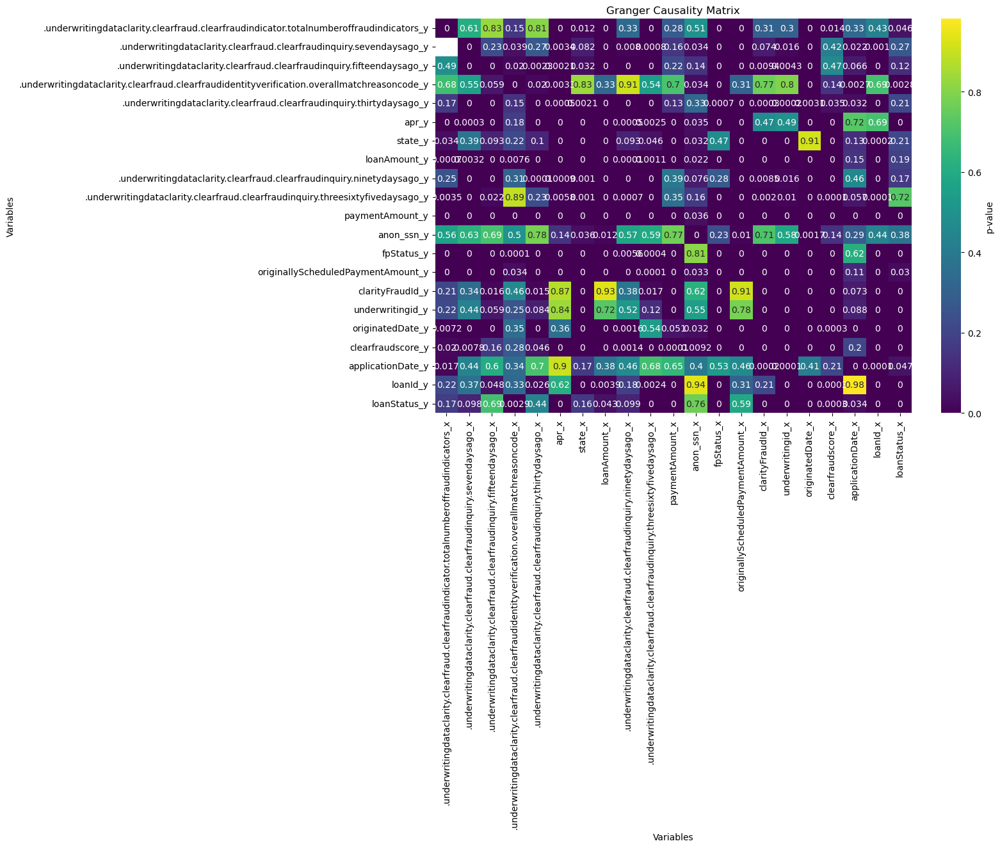

In [68]:
# Visualize the Granger causality matrix
plt.figure(figsize=(12, 8))
sns.heatmap(granger_matrix, annot=True, cmap='viridis', cbar_kws={'label': 'p-value'})
plt.title('Granger Causality Matrix')
plt.xlabel('Variables')
plt.ylabel('Variables')
plt.show()


4.3 Feature Significance from Granger Causality:

This function identifies significant causal relationships from the Granger causality matrix, focusing on those with p-values below a specified significance level (0.05 by default). It filters and prints variables that can significantly predict 'loanStatus', along with their corresponding p-values. This step is crucial for understanding which features have predictive power over 'loanStatus', aiding in feature selection and model refinement for loan risk prediction.

    The significant features gotten from the granger causality matrix will be used to build the Causal Model with DoWhy Library next!!!!

In [69]:
# Function to list significant features from the Granger causality matrix
def list_significant_relationships(granger_matrix, significance_level=0.05):
    significant_relationships = []

    for row in granger_matrix.index:
        for col in granger_matrix.columns:
            p_value = granger_matrix.loc[row, col]
            if p_value < significance_level and not np.isnan(p_value):
                significant_relationships.append((row, col, p_value))
    
    return significant_relationships

# Generate the list of significant features
significant_relationships = list_significant_relationships(granger_matrix, significance_level=0.05)

# Filter and print the significant features
print("\nVariables that can significantly predict 'loanStatus' and their p Values:\n")
for row, col, p_value in significant_relationships:
    if col == 'loanStatus_x':
        print(f"{row}: {p_value:.4f}.")



Variables that can significantly predict 'loanStatus' and their p Values:

.underwritingdataclarity.clearfraud.clearfraudindicator.totalnumberoffraudindicators_y: 0.0463.
.underwritingdataclarity.clearfraud.clearfraudidentityverification.overallmatchreasoncode_y: 0.0028.
apr_y: 0.0000.
paymentAmount_y: 0.0000.
fpStatus_y: 0.0000.
originallyScheduledPaymentAmount_y: 0.0301.
clarityFraudId_y: 0.0000.
underwritingid_y: 0.0000.
originatedDate_y: 0.0000.
clearfraudscore_y: 0.0000.
applicationDate_y: 0.0471.
loanId_y: 0.0000.
loanStatus_y: 0.0000.


#### 5. Causal AI Analysis with DoWhy Library

Causal AI aims to understand the underlying reasons behind events and outcomes by distinguishing causation from mere correlation. For instance, consider the relationship between loan approval and loan default risk. Data might show that borrowers with higher loan amounts tend to default more frequently. However, this correlation alone doesn't imply that higher loan amounts directly cause defaults. Other factors, like the borrower's credit score, income stability, or economic conditions, could also play significant roles.

Causal AI uses tools like the DoWhy library in Python to model and test these causal relationships, ensuring that decisions and predictions are based on true causative effects rather than misleading correlations. This approach is crucial for businesses, such as banks, to make informed, effective decisions based on reliable insights into what truly drives financial movements, for example, loan default risk, rather than just patterns in the historical data.

    Examples of positive and negative causal effects are shown below.

In [70]:
# Function to analyse Causal AI
print("\nFunction for Causal AI Analysis. Function is called below.\n")

# Explain the causal relationship found using DoWhy Causal model
def causal_analysis(causal_model, identified_estimand, causal_estimate):
    # View the model
    model_view = causal_model.view_model()
    model_view
    print("Identified Estimand: ")
    print(identified_estimand)

    print("\nCausal Estimate: ")
    print(causal_estimate)

    print("\nRefutation: ")
    refutation = causal_model.refute_estimate(identified_estimand, causal_estimate, method_name="random_common_cause")
    print(refutation)
    treatment_effect = causal_estimate.value
    # Summarize the causal impact
    if treatment_effect > 0:
        print(f"\nIncreasing the {treatment} leads to an increase in {outcome}.")
    elif treatment_effect < 0:
        print(f"\nIncreasing the {treatment} leads to a decrease in {outcome}.")
    else:
        print(f"\nThere is no significant causal effect of {treatment} on {outcome}.")

    return treatment_effect



Function for Causal AI Analysis. Function is called below.



5.1 Positive Causal Effect:

Uses the PC algorithm to create a causal relationship graph between the features in the data. A causal model is then created with specified treatment, outcome, and common causes, identifying and estimating the causal effect of the treatment on the outcome using linear regression. The function causal_analysis further validates the model by visualizing it, printing the identified estimand and causal estimate, performing a refutation test, and summarizing the impact. The analysis indicates that the treatment variable 'clearfraudscore' has a positive effect on the classification outcome of target variable 'loanStatus', providing valuable insights for improving loan underwriting and risk management processes.

  0%|          | 0/21 [00:00<?, ?it/s]

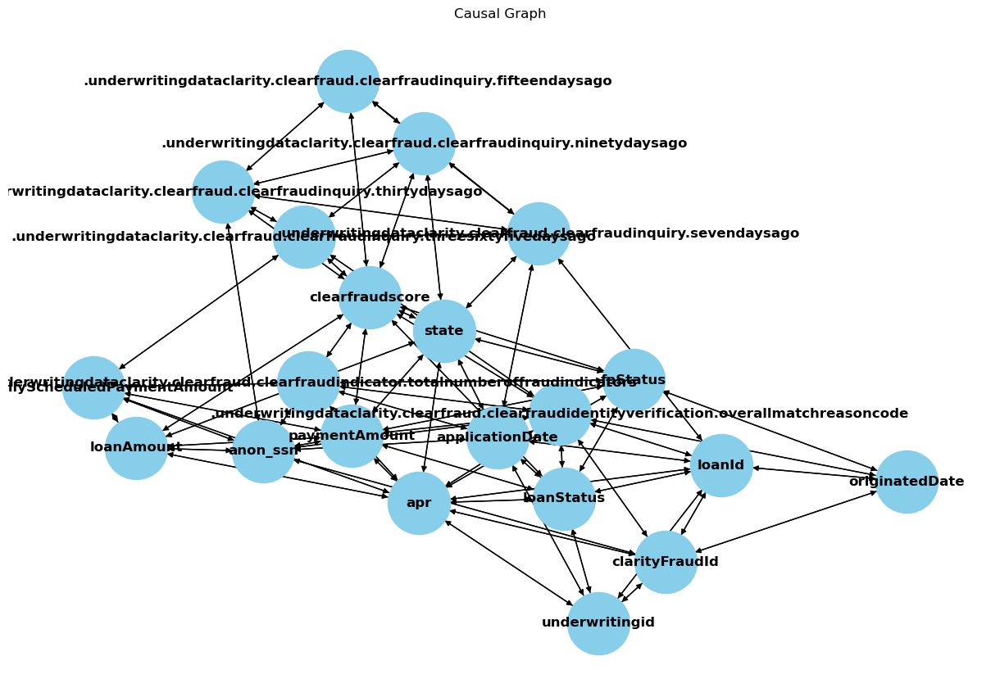

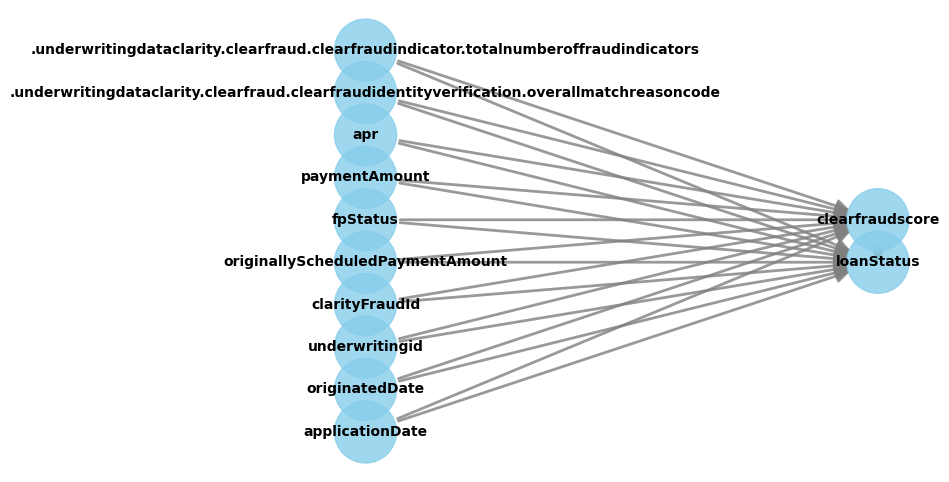

Identified Estimand: 
Estimand type: EstimandType.NONPARAMETRIC_ATE

### Estimand : 1
Estimand name: backdoor
Estimand expression:
        d                                                                     
──────────────────(E[loanStatus|fpStatus,apr,clarityFraudId,originallySchedule
d[clearfraudscore]                                                            

                                                                              
dPaymentAmount,underwritingid,.underwritingdataclarity.clearfraud.clearfraudid
                                                                              

                                                                              
entityverification.overallmatchreasoncode,applicationDate,originatedDate,payme
                                                                              

                                                                              
ntAmount,.underwritingdataclarity.clearfraud.clearfraudindicator.totalnumber

In [71]:
# Perform causal discovery using PC algorithm
pc_model = pc(clean_data.to_numpy())
graph = pc_model.G

# Convert adjacency matrix to edge list
adj_matrix = graph.graph
edges = [(i, j) for i in range(adj_matrix.shape[0]) for j in range(adj_matrix.shape[1]) if adj_matrix[i, j] != 0]

# Visualize the causal graph using networkx
G = nx.DiGraph()
G.add_edges_from(edges)
labels = {i: col for i, col in enumerate(clean_data.columns)}
G = nx.relabel_nodes(G, labels)

plt.figure(figsize=(12, 8))
pos = nx.spring_layout(G)
nx.draw(G, pos, with_labels=True, node_size=3000, node_color='skyblue', font_size=12, font_weight='bold')
plt.title("Causal Graph")
plt.show()

# Define treatment and outcome
treatment = "clearfraudscore"
outcome = "loanStatus"
common_causes = [    
    '.underwritingdataclarity.clearfraud.clearfraudindicator.totalnumberoffraudindicators',
    '.underwritingdataclarity.clearfraud.clearfraudidentityverification.overallmatchreasoncode',
    'apr',
    'paymentAmount',
    'fpStatus',
    'originallyScheduledPaymentAmount',
    'clarityFraudId',
    'underwritingid',
    'originatedDate',
    'applicationDate'
]

# Create a causal model using DoWhy
causal_model = CausalModel(
    data=clean_data,
    treatment=treatment,
    outcome=outcome,
    common_causes=common_causes
)

# Identify the causal effect
identified_estimand = causal_model.identify_effect()

# Estimate the causal effect using linear regression
causal_estimate = causal_model.estimate_effect(identified_estimand, method_name="backdoor.linear_regression")

causal_effect = causal_analysis(causal_model, identified_estimand, causal_estimate)

print(f"\nSummary:\nThe causal analysis suggests that the '{treatment}' has a {('positive' if causal_effect > 0 else 'negative' if causal_effect < 0 else 'neutral')} effect on the '{outcome}'. This insight helps understand the key factors influencing loan repayment status and can guide decision-making in loan underwriting and risk management.")



5.2 Negative Causal Effect:

Justification is same as positive causal effect. The analysis indicates that the treatment variable 'loanAmount' has a negative effect on the classification outcome of target variable 'loanStatus', providing valuable insights for improving loan underwriting and risk management processes.

  0%|          | 0/21 [00:00<?, ?it/s]

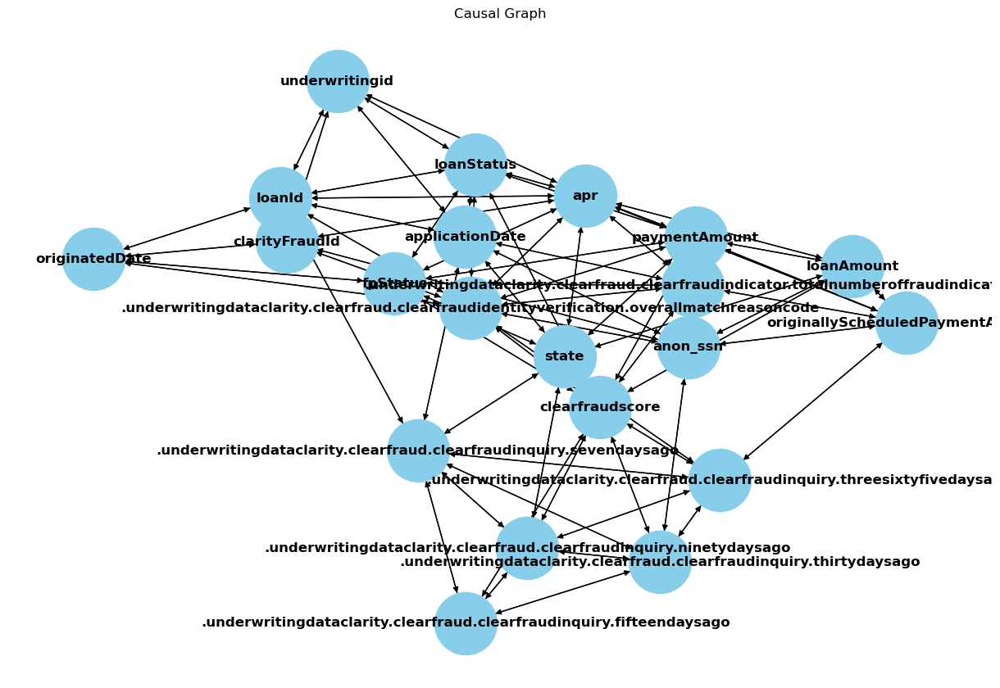

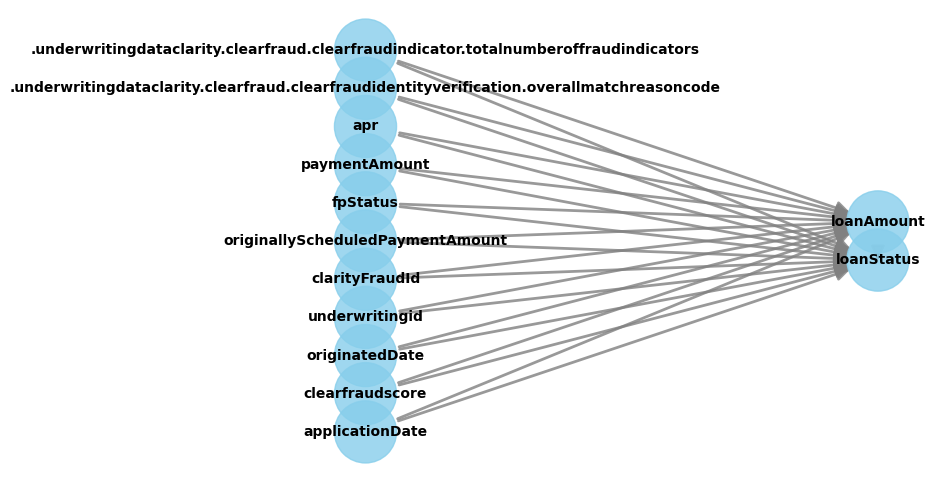

Identified Estimand: 
Estimand type: EstimandType.NONPARAMETRIC_ATE

### Estimand : 1
Estimand name: backdoor
Estimand expression:
      d                                                                       
─────────────(E[loanStatus|fpStatus,apr,clarityFraudId,originallyScheduledPaym
d[loanAmount]                                                                 

                                                                              
entAmount,underwritingid,.underwritingdataclarity.clearfraud.clearfraudidentit
                                                                              

                                                                              
yverification.overallmatchreasoncode,applicationDate,originatedDate,clearfraud
                                                                              

                                                                              
score,paymentAmount,.underwritingdataclarity.clearfraud.clearfraudindicator.

In [72]:
# Perform causal discovery using PC algorithm
pc_model = pc(clean_data.to_numpy())
graph = pc_model.G

# Convert adjacency matrix to edge list
adj_matrix = graph.graph
edges = [(i, j) for i in range(adj_matrix.shape[0]) for j in range(adj_matrix.shape[1]) if adj_matrix[i, j] != 0]

# Visualize the causal graph using networkx
G = nx.DiGraph()
G.add_edges_from(edges)
labels = {i: col for i, col in enumerate(clean_data.columns)}
G = nx.relabel_nodes(G, labels)

plt.figure(figsize=(12, 8))
pos = nx.spring_layout(G)
nx.draw(G, pos, with_labels=True, node_size=3000, node_color='skyblue', font_size=12, font_weight='bold')
plt.title("Causal Graph")
plt.show()

# Define treatment and outcome
treatment = "loanAmount"
outcome = "loanStatus"
common_causes = [    
    '.underwritingdataclarity.clearfraud.clearfraudindicator.totalnumberoffraudindicators',
    '.underwritingdataclarity.clearfraud.clearfraudidentityverification.overallmatchreasoncode',
    'apr',
    'paymentAmount',
    'fpStatus',
    'originallyScheduledPaymentAmount',
    'clarityFraudId',
    'underwritingid',
    'originatedDate',
    'clearfraudscore',
    'applicationDate'
]

# Create a causal model using DoWhy
causal_model = CausalModel(
    data=clean_data,
    treatment=treatment,
    outcome=outcome,
    common_causes=common_causes
)

# Identify the causal effect
identified_estimand = causal_model.identify_effect()

# Estimate the causal effect using linear regression
causal_estimate = causal_model.estimate_effect(identified_estimand, method_name="backdoor.linear_regression")


causal_effect = causal_analysis(causal_model, identified_estimand, causal_estimate)

print(f"\nSummary:\nThe causal analysis suggests that the '{treatment}' has a {('positive' if causal_effect > 0 else 'negative' if causal_effect < 0 else 'neutral')} effect on the '{outcome}'. This insight helps understand the key factors influencing loan repayment status and can guide decision-making in loan underwriting and risk management.")



#### 6. Split the Data

In [73]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_reduced, y, test_size=0.2, random_state=42)

print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)


(449878, 20) (112470, 20) (449878,) (112470,)


#### 7. Sensible Model Training

Initializes and evaluates five machine learning models: Logistic Regression, Decision Tree, Random Forest, Gradient Boosting, and Artificial Neural Network. Each model is trained on the training dataset and evaluated on the test dataset using various performance metrics, including accuracy, precision, recall, F1 score, and ROC AUC. The results are printed for each model, allowing for comparison to identify the best-performing model(Decision tree classifier). This comprehensive evaluation helps determine the most effective model for loan risk prediction, guiding further prediction and decision-making processes.

In [74]:
# Initialize models
models = {
    'Logistic Regression': LogisticRegression(max_iter=100, random_state=42),
    'Decision Tree': DecisionTreeClassifier(max_depth=100, random_state=42, min_samples_leaf=2),
    'Random Forest': RandomForestClassifier(n_estimators=50, max_depth=10, random_state=42, n_jobs=-1),
    'Gradient Boosting': GradientBoostingClassifier(n_estimators=50, learning_rate=0.1, subsample=0.8, random_state=42),
    'Artificial Neural Network': MLPClassifier(hidden_layer_sizes=(100,), max_iter=100, random_state=42, early_stopping=True, verbose=True)
}

# Train and evaluate models
results = {}

for model_name, model in models.items():
    # Train the model
    model.fit(X_train, y_train)
    
    # Make predictions
    y_pred = model.predict(X_test)
    
    # Calculate probability estimates for ROC AUC
    if hasattr(model, "predict_proba"):
        y_prob = model.predict_proba(X_test)[:, 1]
    else:
        y_prob = model.decision_function(X_test)
        # Normalize decision function output to [0, 1]
        y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())

    # Calculate metrics
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    f1 = f1_score(y_test, y_pred, average='weighted')
    roc_auc = roc_auc_score(y_test, y_prob, multi_class='ovr')

    # Store results
    results[model_name] = {
        'Accuracy': accuracy,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1,
        'ROC AUC': roc_auc
    }
    
    # Print results
    print(f"{model_name} Results:")
    print(f"Accuracy: {accuracy:.4f}")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1 Score: {f1:.4f}")
    print(f"ROC AUC: {roc_auc:.4f}")
    print("\n")


Logistic Regression Results:
Accuracy: 0.7098
Precision: 0.6448
Recall: 0.7098
F1 Score: 0.6477
ROC AUC: 0.6993


Decision Tree Results:
Accuracy: 0.9974
Precision: 0.9974
Recall: 0.9974
F1 Score: 0.9974
ROC AUC: 0.9973


Random Forest Results:
Accuracy: 0.8112
Precision: 0.8023
Recall: 0.8112
F1 Score: 0.8018
ROC AUC: 0.8653


Gradient Boosting Results:
Accuracy: 0.7791
Precision: 0.7639
Recall: 0.7791
F1 Score: 0.7619
ROC AUC: 0.8160


Iteration 1, loss = 14.09392212
Validation score: 0.726927
Iteration 2, loss = 13.59399534
Validation score: 0.726927
Iteration 3, loss = 13.24657310
Validation score: 0.726927
Iteration 4, loss = 13.15850907
Validation score: 0.726927
Iteration 5, loss = 13.12177062
Validation score: 0.281253
Iteration 6, loss = 13.17067962
Validation score: 0.726927
Iteration 7, loss = 13.14250505
Validation score: 0.280697
Iteration 8, loss = 13.15510226
Validation score: 0.679381
Iteration 9, loss = 13.22892230
Validation score: 0.712501
Iteration 10, loss = 13.029

#### 8. Model Visualization and Evidence

The code visualizes the performance of multiple machine learning models by plotting their ROC AUC scores, confusion matrices, and actual vs predicted values, which collectively validate model accuracy and appropriateness. The ROC AUC bar plot ranks the models based on their ability to distinguish between classes, highlighting the best-performing model. The confusion matrix for this top model provides a detailed view of its classification accuracy by displaying true positives, true negatives, false positives, and false negatives, thus revealing the model's strengths and weaknesses in predicting each class. The scatter plot of actual vs predicted values allows for visual assessment of the model's prediction accuracy, with points along the diagonal line indicating perfect predictions. The line plot for the first 100 instances further illustrates the model's performance over a sequence, showing how closely predicted values follow the actual values. 

These visualizations are appropriate as they offer different perspectives on model performance, ensuring a thorough evaluation by considering various metrics and graphical representations, ultimately guiding the selection of the most effective model for loan risk prediction and suggesting areas for further improvement.

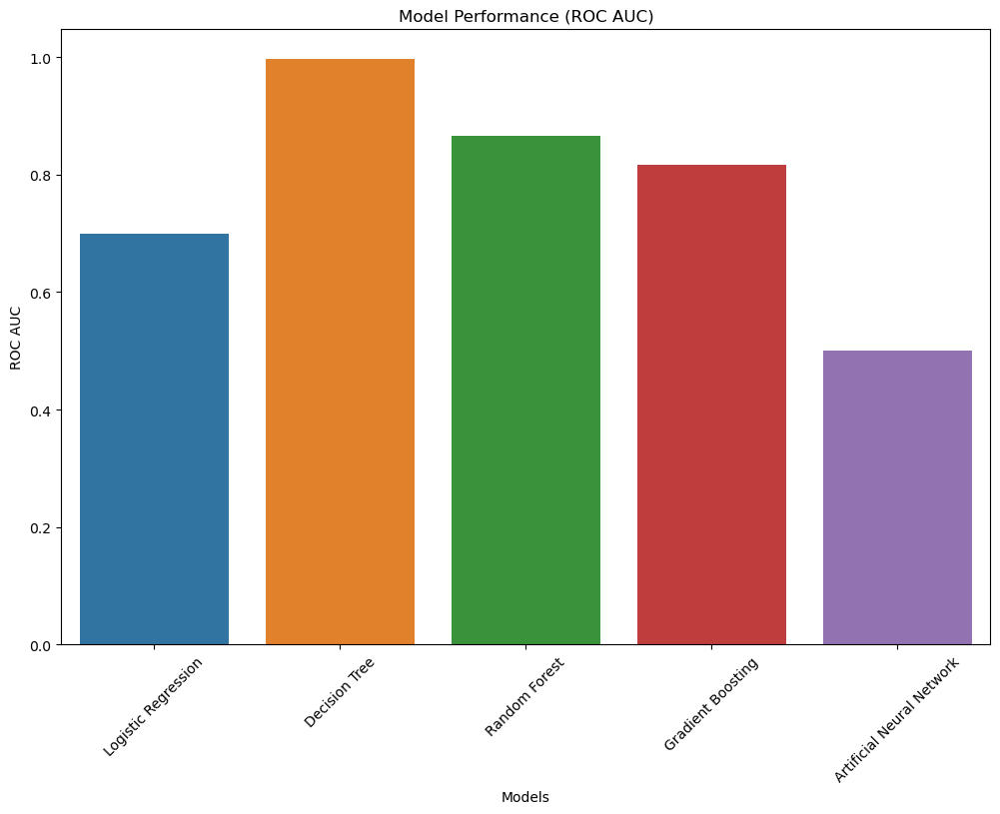

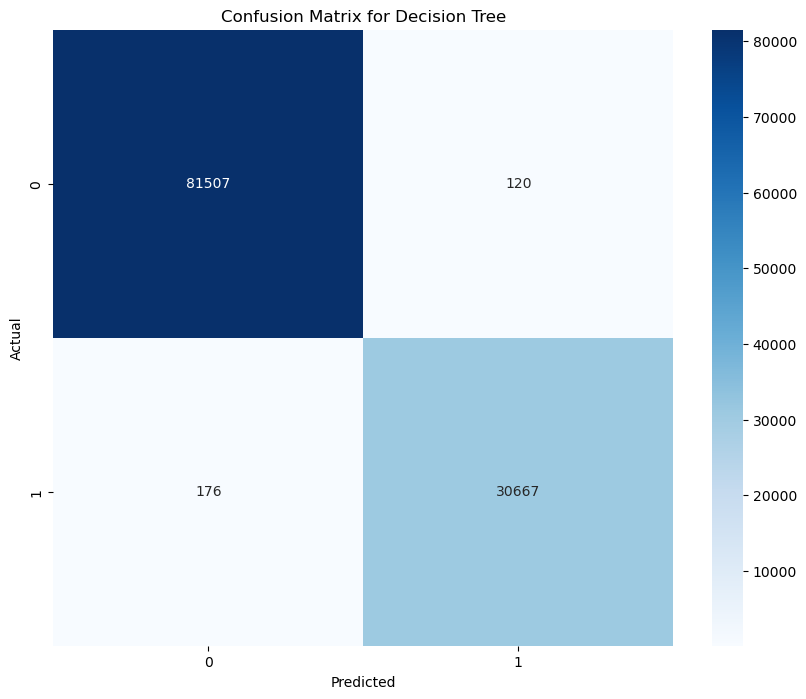

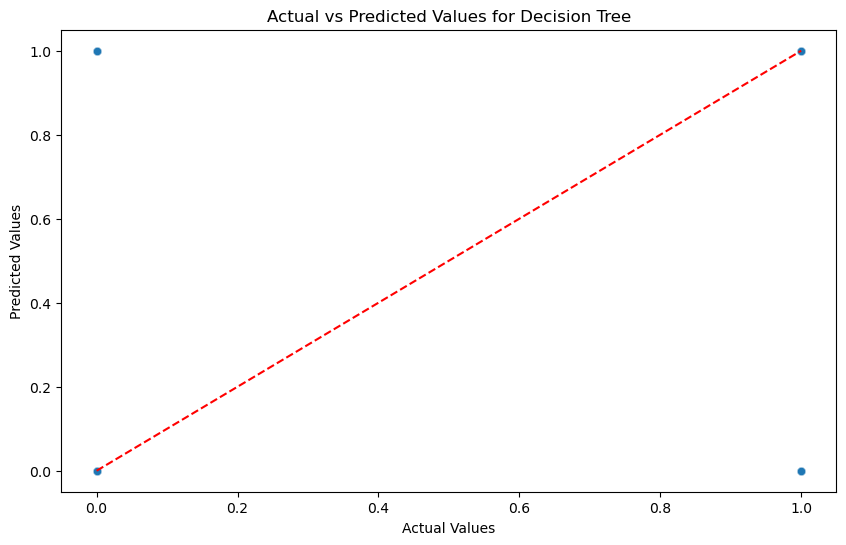

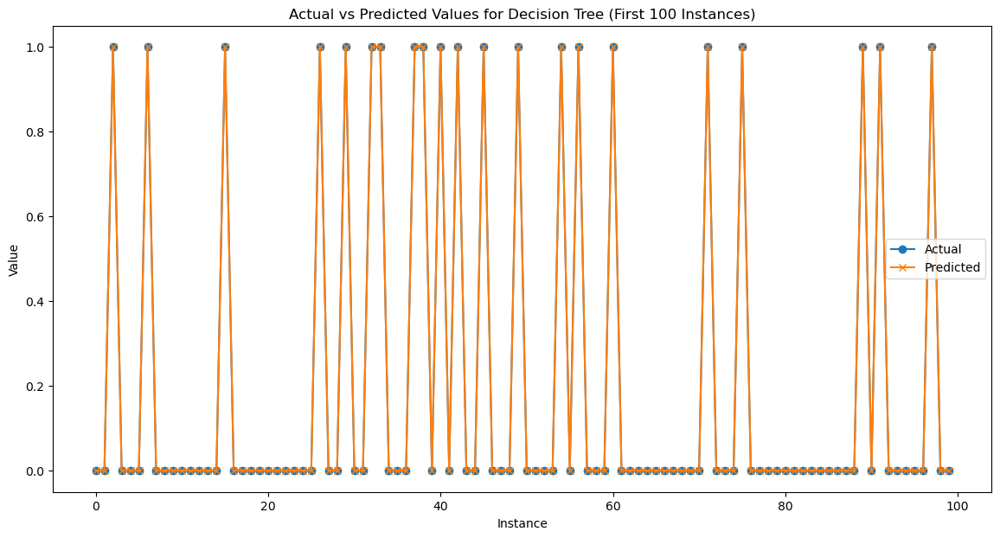

In [75]:
# Convert results dictionary to DataFrame for easier visualization
results_df = pd.DataFrame(results).T

# Plot the ROC AUC scores for each model
plt.figure(figsize=(12, 8))
sns.barplot(x=results_df.index, y='ROC AUC', data=results_df)
plt.title('Model Performance (ROC AUC)')
plt.ylabel('ROC AUC')
plt.xlabel('Models')
plt.xticks(rotation=45)
plt.show()

# Display confusion matrix for the best model based on ROC AUC
best_model_name = results_df['ROC AUC'].idxmax()
best_model = models[best_model_name]
y_pred_best = best_model.predict(X_test)

conf_matrix = confusion_matrix(y_test, y_pred_best)
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.title(f'Confusion Matrix for {best_model_name}')
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.show()

# Create a DataFrame with actual and predicted values
actual_vs_predicted_df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred_best})

# Scatter plot for Actual vs Predicted
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Actual', y='Predicted', data=actual_vs_predicted_df, alpha=0.3)
plt.plot([0, 1], [0, 1], color='red', linestyle='--')  # Diagonal line
plt.title(f'Actual vs Predicted Values for {best_model_name}')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.show()

# Line plot for Actual vs Predicted
plt.figure(figsize=(14, 7))
plt.plot(y_test.values[:100], label='Actual', marker='o')
plt.plot(y_pred_best[:100], label='Predicted', marker='x')
plt.title(f'Actual vs Predicted Values for {best_model_name} (First 100 Instances)')
plt.xlabel('Instance')
plt.ylabel('Value')
plt.legend()
plt.show()


#### 9. Predicted Loan Risk on an Applicant

This function predicts loan risks for all records in the dataset using the best-performing model identified earlier. The function uses the best model to predict loan risks, translating numerical predictions into 'Safe' or 'Risky' statuses for interpretability. A results DataFrame is created with loan IDs, predicted risks, and statuses, which is then saved to a CSV file for easy access and further analysis. 

    This systematic approach ensures accurate predictions and provides a clear, accessible format for reviewing the model's output, aiding in effective loan risk assessment.

In [76]:
def predict_all_loan_risks(loan_df, X_reduced, best_model):
    # Ensure indices are aligned
    loan_df.reset_index(drop=True, inplace=True)
    X_reduced.reset_index(drop=True, inplace=True)
    
    # Filter the loan_df to match the X_reduced indices
    filtered_loan_df = loan_df.loc[X_reduced.index]
    
    # Fetch the filtered loan IDs
    loan_ids = filtered_loan_df['loanId']
    
    # Predict the loan risk for all records in X_reduced
    y_pred_full = best_model.predict(X_reduced)
    
    # Determine the status (Safe/Risky) based on the predicted risk
    risk_status = ['Safe' if risk == 1 else 'Risky' for risk in y_pred_full]
    
    # Create a DataFrame with loanId and the predicted loan risk
    results_df = pd.DataFrame({
        'loanId': loan_ids,
        'PredictedRisk': y_pred_full,
        'Status': risk_status
    })
    
    # Save the results to a CSV file
    results_df.to_csv('predicted_loan_risk.csv', index=False)
    
    return results_df

# Example usage
result_df = predict_all_loan_risks(loan_df, X_reduced, best_model)

# Display a random sample of the output DataFrame
print(result_df.sample(10))



               loanId  PredictedRisk Status
460908  LL-I-06739720              0  Risky
319771  LL-I-17177116              0  Risky
343381  LL-I-05606959              0  Risky
402689  LL-I-06768702              0  Risky
430804  LL-I-01575489              1   Safe
264944  LL-I-16365576              0  Risky
125060  LL-I-05833098              1   Safe
15058   LL-I-17402949              1   Safe
444325  LL-I-06604519              0  Risky
353992  LL-I-00967320              0  Risky


#### 10. Explanable AI

Explainable AI(XAI) refers to a set of processes and methods that aim to provide a clear and human-understandable explanation for the decisions generated by AI and machine learning models. Integrating an explainability layer into these models, Data Scientists and Machine Learning practitioners can create more trustworthy and transparent systems to assist a wide range of stakeholders such as developers, regulators, and end-users.

10.1 Classification Report:

The model achieved an overall accuracy of 75%, with a higher precision and recall for class '0' (Risky) compared to class '1' (Safe). The weighted averages show a balanced performance across the classes, indicating the model's effectiveness in predicting loan risks. The decision tree visualization further aids in interpreting the model's decisions and understanding the factors influencing loan risk predictions.

10.2 Tree Diagram:

The decision tree is visualized, highlighting the feature splits and class probabilities, which aids in understanding the model's decision-making process.

The tree diagram, produced by the decision tree visualization, is an essential tool in Explainable AI. Each node in the diagram represents a decision point based on a feature from the dataset, with branches leading to subsequent nodes depending on the feature's value. The root node starts with the most significant feature split, progressively branching out to nodes with more specific conditions. Leaf nodes at the end of branches indicate the final prediction of 'Risky' or 'Safe' status. The colors in the nodes represent the predicted class probabilities, providing a visual cue to the likelihood of each class. This detailed visual representation helps understand the rationale behind each prediction, making the model's decisions transparent and easier to trust.

              precision    recall  f1-score   support

           0       0.80      0.87      0.84     81627
           1       0.56      0.43      0.49     30843

    accuracy                           0.75    112470
   macro avg       0.68      0.65      0.66    112470
weighted avg       0.74      0.75      0.74    112470



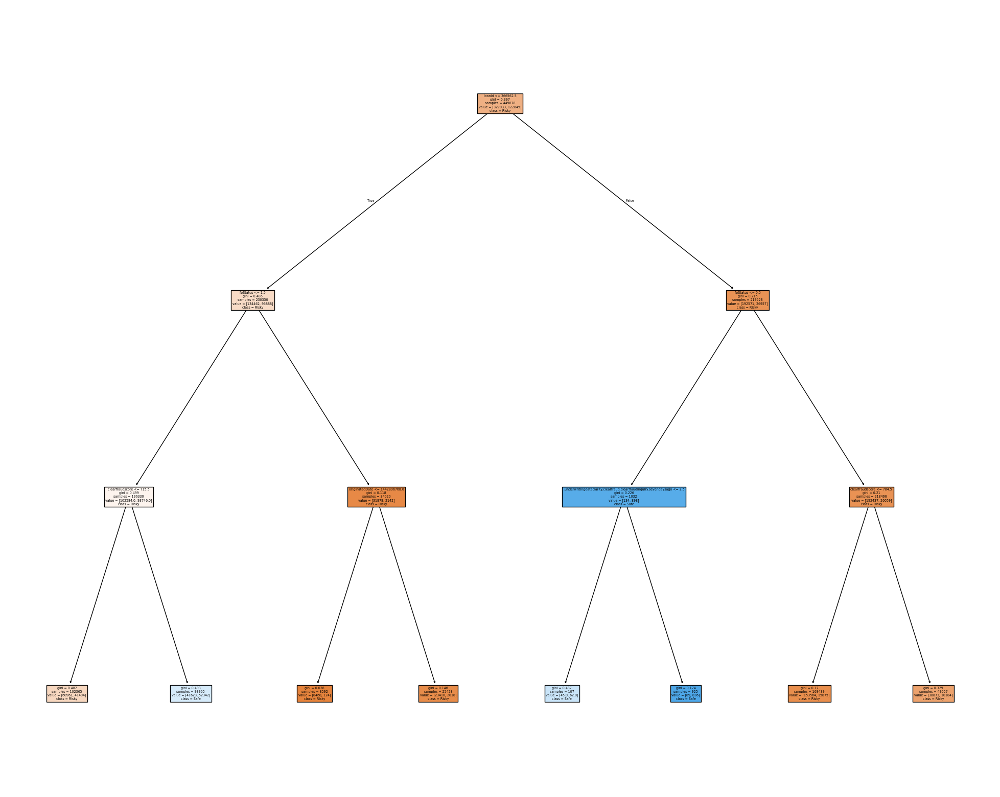

In [77]:
# Train the Decision Tree model with specific hyperparameters
xAI = DecisionTreeClassifier(max_depth=3, min_samples_leaf=2)
xAI.fit(X_train, y_train)

# Predict on the test data and evaluate the model
y_pred = xAI.predict(X_test)

# Print the classification report
print(classification_report(y_test, y_pred))

# Plot the decision tree
plt.figure(figsize=(25, 20))
plot_tree(xAI, feature_names=X_reduced.columns, class_names=['Risky', 'Safe'], filled=True)
plt.show()


#### 11. Model Validation

Cross-validation on the trained Decision Tree model to evaluate its generalizability and robustness. By splitting the data into five folds and training the model on each subset while evaluating it on the remaining data, the code provides a reliable estimate of model performance. The cross-validation scores, which range from approximately 74.8% to 75.9% accuracy, indicate the model's consistency across different data subsets. The mean cross-validation score of approximately 75.2% confirms that the model maintains stable performance and is not overfitting to a single train-test split. This robust evaluation process enhances confidence in the model's ability to predict loan risks accurately when applied to new, unseen data.

In [78]:
scores = cross_val_score(xAI, X_reduced, y, cv=5, scoring='accuracy')
print("Cross-validation scores:", scores)
print("Mean cross-validation score:", np.mean(scores))


Cross-validation scores: [0.75348093 0.74919534 0.75925136 0.74818839 0.75004668]
Mean cross-validation score: 0.7520325388727113
